In [ ]:
# Task-1:- In this task we will understand and manipulate an image.
# 1. Read the image
# 2. Display the image
# 3. Extraction of Image size
# 4. Calculation image pixels
# 5. Convert RGB to Grayscale image
# 6. Convert RGB to Grayscale image and Binary image by using a threshold.
# i. Also, Count the area of black pixels and size of image
# Note:- OpenCV uses BGR (Blue, green,red) format. So when we open an image in cv2 it
# is BGR by default. We need to convert it into RGB, and then gray format. Give a new
# name to the image after every conversion.

In [ ]:
pip install opencv-python

In [ ]:
from google.colab.patches import cv2_imshow  # Import for Colab
import cv2
import numpy as np
from skimage import filters, segmentation
import matplotlib.pyplot as plt

In [ ]:
image_sample = cv2.imread("1.png")
cv2_imshow(image_sample)

In [ ]:
image_sample.shape

(2160, 3840, 3)

In [ ]:
def task1(image_path):
    image = cv2.imread(image_path)

    cv2_imshow(image)

    image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    cv2.imwrite("image_rgb.jpg", image_rgb)

    height, width, channels = image.shape
    print(f"Image Size: {width}x{height}, Channels: {channels}")

    total_pixels = height * width
    print(f"Total Pixels: {total_pixels}")

    gray_image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    cv2.imwrite("gray_image.jpg", gray_image)
    cv2_imshow(gray_image)

    # 6. Convert to binary image using thresholding
    threshold_value, binary_image = cv2.threshold(gray_image, 127, 255, cv2.THRESH_BINARY)
    cv2.imwrite("binary_image.jpg", binary_image)
    cv2_imshow(binary_image)

    # Count black pixel area
    black_pixel_count = np.sum(binary_image == 0)
    print(f"Black Pixel Count: {black_pixel_count}")

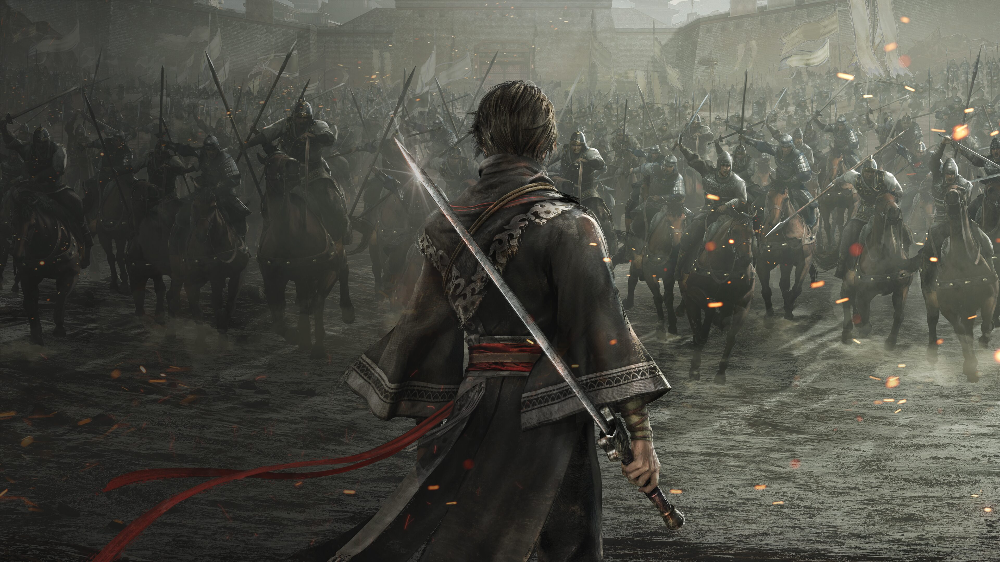

Image Size: 3840x2160, Channels: 3
Total Pixels: 8294400


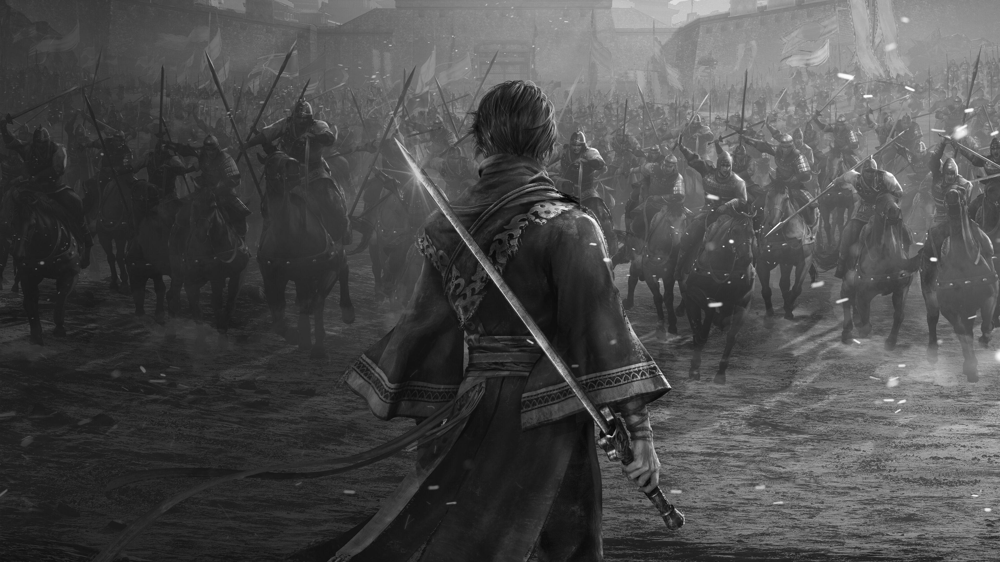

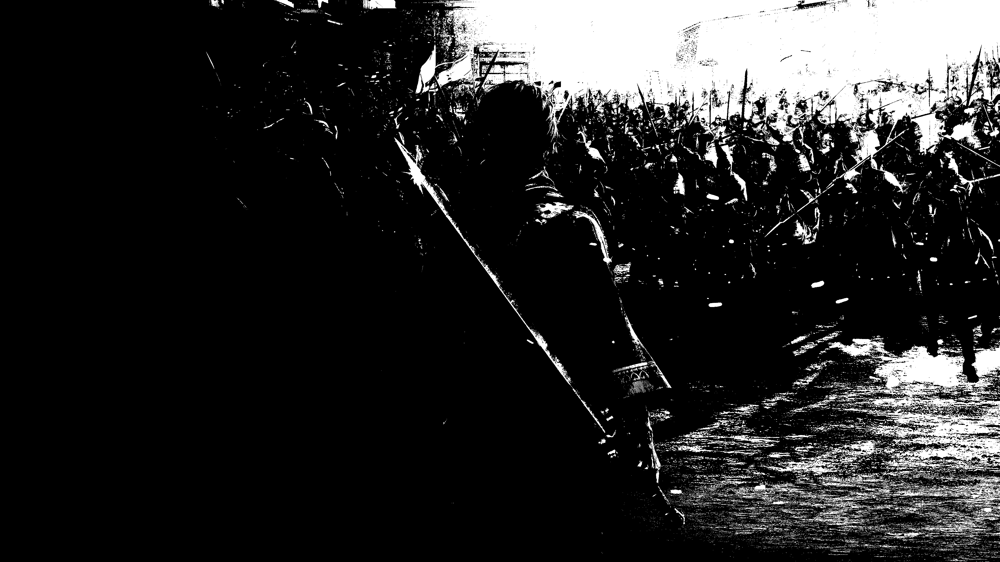

Black Pixel Count: 6988485


In [ ]:
task1("1.png")

In [ ]:
# Grayscale images have only one channel (instead of three like RGB), making edge detection easier.so try to change first


In [ ]:
def task2(image_path):
    image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)

    # 1. Edge Detection
    sobel_x = cv2.Sobel(image, cv2.CV_64F, 1, 0, ksize=3)

    sobel_y = cv2.Sobel(image, cv2.CV_64F, 0, 1, ksize=3)
    sobel = cv2.magnitude(sobel_x, sobel_y)

    prewitt_x = filters.prewitt_h(image)
    prewitt_y = filters.prewitt_v(image)
    prewitt = np.hypot(prewitt_x, prewitt_y)

    roberts = filters.roberts(image)

    canny = cv2.Canny(image, 100, 200)

    # 2. Image Segmentation
    global_thresh = cv2.threshold(image, 127, 255, cv2.THRESH_BINARY)[1]
    adaptive_thresh = cv2.adaptiveThreshold(image, 255, cv2.ADAPTIVE_THRESH_MEAN_C, cv2.THRESH_BINARY, 11, 2)

    edges = cv2.Canny(image, 100, 200)

    markers = cv2.watershed(cv2.cvtColor(image, cv2.COLOR_GRAY2BGR), np.int32(image))
    watershed_seg = segmentation.watershed(-image, markers)

    # Display Results
    fig, axs = plt.subplots(3, 3, figsize=(10, 10))
    axs[0, 0].imshow(sobel, cmap='gray'); axs[0, 0].set_title("Sobel")
    axs[0, 1].imshow(prewitt, cmap='gray'); axs[0, 1].set_title("Prewitt")
    axs[0, 2].imshow(roberts, cmap='gray'); axs[0, 2].set_title("Roberts")
    axs[1, 0].imshow(canny, cmap='gray'); axs[1, 0].set_title("Canny")
    axs[1, 1].imshow(global_thresh, cmap='gray'); axs[1, 1].set_title("Global Threshold")
    axs[1, 2].imshow(adaptive_thresh, cmap='gray'); axs[1, 2].set_title("Adaptive Threshold")
    axs[2, 0].imshow(edges, cmap='gray'); axs[2, 0].set_title("Canny Segmentation")
    axs[2, 1].imshow(watershed_seg, cmap='gray'); axs[2, 1].set_title("Watershed")
    axs[2, 2].imshow(watershed_seg, cmap='gray'); axs[2, 2].set_title("Watershed")
    plt.tight_layout()

    plt.show()



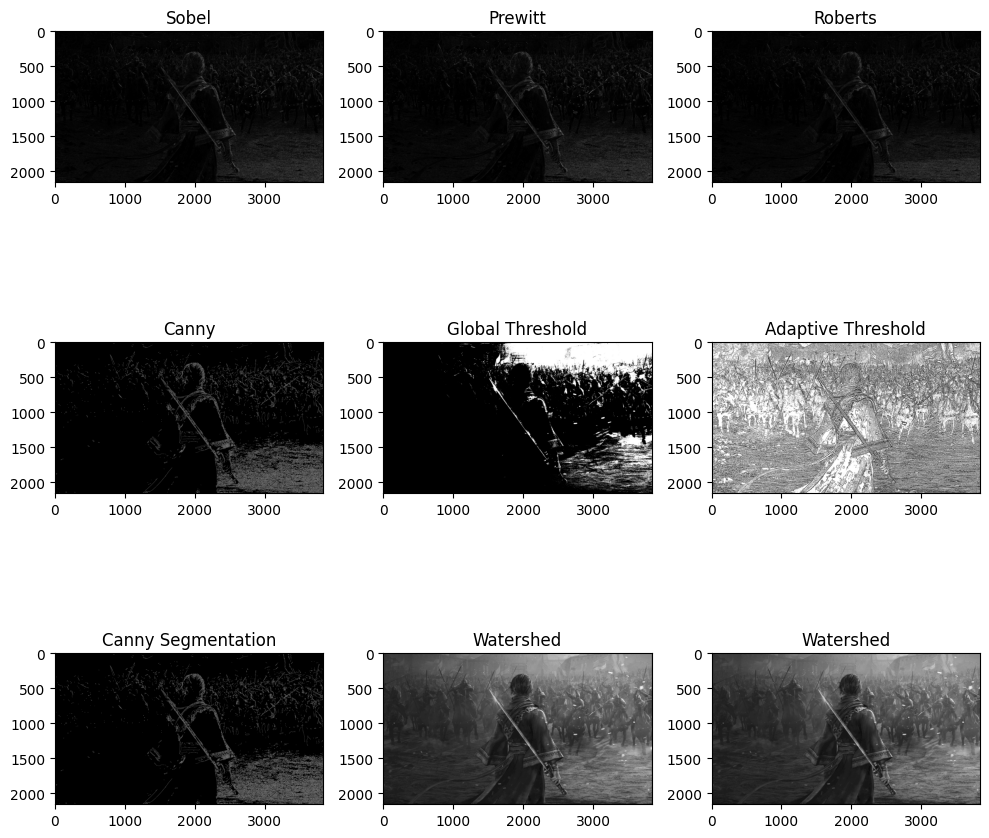

In [ ]:
task2("1.png")

In [ ]:
# import cv2
# import numpy as np
# import matplotlib.pyplot as plt

# # Load the image
# image = cv2.imread("coins.jpg")
# gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

# # Apply thresholding to segment the objects
# _, binary = cv2.threshold(gray, 0, 255, cv2.THRESH_BINARY_INV + cv2.THRESH_OTSU)

# # Remove small noise using morphological opening
# kernel = np.ones((3, 3), np.uint8)
# opening = cv2.morphologyEx(binary, cv2.MORPH_OPEN, kernel, iterations=2)

# # Determine the sure background area
# sure_bg = cv2.dilate(opening, kernel, iterations=3)

# # Determine the sure foreground area using distance transform
# dist_transform = cv2.distanceTransform(opening, cv2.DIST_L2, 5)
# _, sure_fg = cv2.threshold(dist_transform, 0.7 * dist_transform.max(), 255, 0)

# # Find the unknown region (possible object boundaries)
# sure_fg = np.uint8(sure_fg)
# unknown = cv2.subtract(sure_bg, sure_fg)

# # Label the markers (background = 1, foreground = 2+)
# _, markers = cv2.connectedComponents(sure_fg)
# markers = markers + 1
# markers[unknown == 255] = 0  # Mark unknown regions as 0

# # Apply the watershed algorithm
# markers = cv2.watershed(image, markers)
# image[markers == -1] = [255, 0, 0]  # Mark object boundaries in red

# # Display the result
# plt.figure(figsize=(10, 5))
# plt.subplot(1, 2, 1)
# plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
# plt.title("Segmented Objects (Watershed)")
# plt.axis("off")

# plt.subplot(1, 2, 2)
# plt.imshow(markers, cmap="jet")
# plt.title("Watershed Markers")
# plt.axis("off")

# plt.show()
